<a href="https://colab.research.google.com/github/summerolmstead/Snow-Crab-Geospatial/blob/main/Snow_Crabs_Geospatial.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

Assignment 3

Snow Crab

Summer Olmstead

The dataset contains catch per unit effort data of commercial snow crab landings in the Alaskan Eastern Bering Sea. The catch per unit effort is an indirect measure of the abundance of a target species. Data was collected by NOAA and cleaned for data analysis

https://www.kaggle.com/datasets/mattop/snowcrab


In [3]:
import kagglehub

# Download latest version
path = kagglehub.dataset_download("mattop/snowcrab")

print("Path to dataset files:", path)

100%|██████████| 314k/314k [00:00<00:00, 59.2MB/s]

Extracting files...
Path to dataset files: /root/.cache/kagglehub/datasets/mattop/snowcrab/versions/2


In [4]:
import os
dataset_files = os.listdir(path)
print("Dataset files:", dataset_files)

Dataset files: ['mfsnowcrab.csv']


In [5]:
import pandas as pd

csv_file_path = os.path.join(path, 'mfsnowcrab.csv')
df = pd.read_csv(csv_file_path)

print(df.head())

       id  latitude  longitude  year       name   sex  bottom_depth  \
0  147038  57.00000 -166.45000  1975  snow crab  male            71   
1  147037  57.00000 -167.08333  1975  snow crab  male            71   
2  147036  57.00000 -167.68333  1975  snow crab  male            75   
3  147035  56.66667 -172.56667  1975  snow crab  male           132   
4  147034  56.66667 -171.96667  1975  snow crab  male           123   

   surface_temperature  bottom_temperature  haul    cpue  
0                  9.1                 1.1   117   40356  
1                  8.7                 1.4   118   68691  
2                  8.8                 1.6   139  119748  
3                  6.1                 2.5    89    7882  
4                  5.7                 2.1    90   11258  


In [6]:
df.describe()

,id,latitude,longitude,year,bottom_depth,surface_temperature,bottom_temperature,haul,cpue
count,17927.000000,17927.000000,17927.000000,17927.000000,17927.000000,17927.000000,17927.000000,17927.000000,1.792700e+04
mean,162675.094048,58.529967,-170.670173,1997.763653,90.006192,7.124287,1.802226,123.805991,3.287569e+04
std,7390.543287,1.674403,3.871000,12.039272,28.336891,1.979158,1.737456,51.736292,1.154277e+05
min,145878.000000,54.666670,-178.223090,1975.000000,22.000000,-1.100000,-2.100000,1.000000,5.200000e+01
25%,158285.500000,57.166220,-173.589910,1988.000000,68.000000,5.900000,0.600000,86.000000,4.830000e+02
50%,163807.000000,58.344670,-170.850250,1998.000000,84.000000,7.300000,2.000000,127.000000,3.215000e+03
75%,168610.500000,59.992260,-167.850550,2008.000000,110.000000,8.600000,3.200000,164.000000,2.100850e+04
max,173422.000000,62.044500,-158.397950,2018.000000,276.000000,14.100000,10.000000,334.000000,5.117962e+06


In [7]:
#the max year in the df
df['year'].max() #2018
#the min tear in the df
df['year'].min() #1975

1975

Data Preprocessing

In [24]:
#missing values check
print(df.isnull().sum())

#percentage of missing values in each column
print(df.isnull().mean() * 100)

#duplicate rows?
print(df.duplicated().sum())

#unsurprising bc dataset was pre cleaned

id                     0
latitude               0
longitude              0
year                   0
name                   0
sex                    0
bottom_depth           0
surface_temperature    0
bottom_temperature     0
haul                   0
cpue                   0
dtype: int64
id                     0.0
latitude               0.0
longitude              0.0
year                   0.0
name                   0.0
sex                    0.0
bottom_depth           0.0
surface_temperature    0.0
bottom_temperature     0.0
haul                   0.0
cpue                   0.0
dtype: float64
0


In [8]:
import pandas as pd
import folium
from folium.plugins import HeatMap

df2 = df.copy()  #copy of the original DataFrame

# relevant columns to use
df2 = df2[["latitude", "longitude", "cpue"]].dropna()

#a Folium map centered around the Bering Sea!
m = folium.Map(location=[57, -168], zoom_start=5)  #centered in the Eastern Bering Sea where crabs are

# heatmap data (Weight = CPUE to show abundance)
heat_data = df2[["latitude", "longitude", "cpue"]].values.tolist()

#heatmap layer
HeatMap(heat_data, radius=8, max_zoom=8).add_to(m)

#save and display the map!
m.save("snow_crab_distribution.html")
m


In [10]:
import folium
from folium.plugins import MarkerCluster

df3 = df.copy()

#a folium map centered on the Bering Sea
m = folium.Map(location=[57, -168], zoom_start=5)

#marker cluster defined
marker_cluster = MarkerCluster().add_to(m)

#adding markers for each data point
for index, row in df3.iterrows():
    folium.Marker(
        location=[row["latitude"], row["longitude"]],
        popup=f"CPUE: {row['cpue']} | Depth: {row['bottom_depth']}m",
        icon=folium.Icon(color="blue", icon="info-sign")
    ).add_to(marker_cluster)

#save and show the map
m.save("snow_crab_cluster_map.html")
m

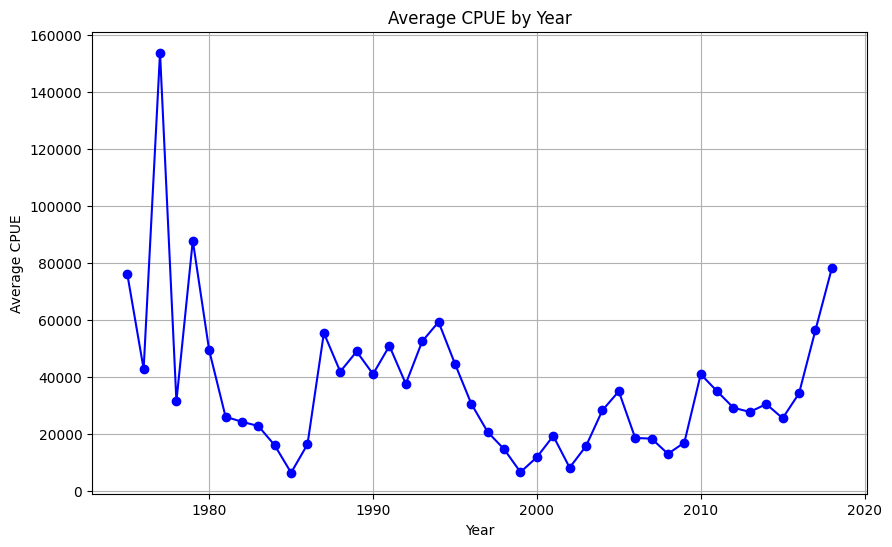

In [21]:
import matplotlib.pyplot as plt

#group by year and calculate mean CPUE
df_yearly = df.groupby('year')['cpue'].mean()

#plot
plt.figure(figsize=(10,6))
plt.plot(df_yearly.index, df_yearly.values, marker='o', linestyle='-', color='b')
plt.title('Average CPUE by Year')
plt.xlabel('Year')
plt.ylabel('Average CPUE')
plt.grid(True)
plt.show()